<a href="https://colab.research.google.com/github/MaxenceAr/RTE/blob/main/TD_ML_IFP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analyse préalable

In [94]:
# Import des libraries utiles
import pandas as pd
import gdown
from scipy.stats import pearsonr
from scipy.stats import spearmanr
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import webbrowser
import matplotlib.pyplot as plt
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import make_scorer, recall_score
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.model_selection import GridSearchCV,KFold
from sklearn.model_selection import train_test_split

In [95]:

# Remplace l'ID ci-dessous par le tien
file_id = '16hrTM2z9qf1vy2nyaeQDcqcT1f0ZfXS1'
url = f'https://drive.google.com/uc?id={file_id}'
output = 'eco2mix.csv'

gdown.download(url, output, quiet=False)

# Lecture du fichier
import pandas as pd
df = pd.read_csv(output, sep=';')

Downloading...
From (original): https://drive.google.com/uc?id=16hrTM2z9qf1vy2nyaeQDcqcT1f0ZfXS1
From (redirected): https://drive.google.com/uc?id=16hrTM2z9qf1vy2nyaeQDcqcT1f0ZfXS1&confirm=t&uuid=d26e4687-2ac4-4694-80ca-670ab1a7ce93
To: /content/eco2mix.csv
100%|██████████| 320M/320M [00:06<00:00, 52.4MB/s]
/tmp/ipython-input-95-862760773.py:10: DtypeWarning:

Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.



TCO : le Taux de COuverture (TCO) d'une filière de production au sein d'une région représente la part de cette filière dans la consommation de cette région

TCH : le Taux de CHarge (TCH) ou facteur de charge (FC) d'une filière représente son volume de production par rapport à la capacité de production installée

# Exploration de données

## Cleaner la data

In [96]:
# Créer un nouveau DataFrame qu'on va cleaner
df_cleaned = df.copy()

# Dans la colonne Eolien (MW), remplacer les 'ND' par des NaN
df_cleaned['Eolien (MW)'] = df_cleaned['Eolien (MW)'].replace('ND', pd.NA)
# Convertir la colonne 'Eolien (MW)' en float (en utilisant pd.to_numeric pour gérer pd.NA)
df_cleaned['Eolien (MW)'] = pd.to_numeric(df_cleaned['Eolien (MW)'], errors='coerce')
# Convertir la colonne 'Date - Heure' en datetime
df_cleaned['Date - Heure'] = pd.to_datetime(df_cleaned['Date - Heure'], format='%Y-%m-%dT%H:%M:%S%z')

# Drop la colonne 'Column 30'
df_cleaned = df_cleaned.drop(columns=['Column 30'])

# Drop les lignes où la 'Date - Heure' est '2012-12-31T23:00:00+00:00'
df_cleaned = df_cleaned[df_cleaned['Date - Heure'] != '2012-12-31T23:00:00+00:00']

# Drop les colonnes 'Date' et 'Heure'
df_cleaned = df_cleaned.drop(columns=['Date', 'Heure'])
df_cleaned = df_cleaned.drop(columns=['Stockage batterie', 'Déstockage batterie', 'Eolien terrestre', 'Eolien offshore'])

## Convertir les données au pas horaire

In [97]:
def make_df_hourly(df):
    """
    Fonction pour créer un DataFrame agrégé au pas horaire.
    """

    # Colonnes de production/consommation en MW
    mw_columns = ['Consommation (MW)', 'Thermique (MW)', 'Nucléaire (MW)', 'Eolien (MW)',
                'Solaire (MW)', 'Hydraulique (MW)', 'Pompage (MW)', 'Bioénergies (MW)',
                'Ech. physiques (MW)']

    # Définir les colonnes de groupement et les fonctions d'agrégation
    grouping_cols = ['Code INSEE région', 'Région', 'Nature']

    # Dictionnaire pour spécifier comment agréger chaque colonne
    # Pour les colonnes catégorielles ou constantes dans le groupe horaire, on prend la première valeur.
    # Pour les colonnes numériques, on prend la moyenne.
    agg_functions = {}
    for col in df_cleaned.columns:
        if col in grouping_cols or col == 'Date - Heure':
            continue # Ces colonnes sont utilisées pour le groupement ou seront l'index
        elif col in mw_columns or 'TCO' in col or 'TCH' in col:
            agg_functions[col] = 'mean' # Moyenne pour les valeurs numériques
        else:
            agg_functions[col] = 'first' # Par défaut pour d'autres colonnes éventuelles

    # Grouper et agréger
    # On groupe par les colonnes régionales ET par heure en utilisant pd.Grouper
    df_hourly = df_cleaned.groupby(
        grouping_cols + [pd.Grouper(key='Date - Heure', freq='H')]
    ).agg(agg_functions)

    # Réinitialiser l'index pour que 'Date - Heure' et les colonnes de groupement redeviennent des colonnes classiques
    df_hourly = df_hourly.reset_index()

    return df_hourly

# Afficher les premières lignes du résultat
df_cleaned_hourly = make_df_hourly(df_cleaned)

/tmp/ipython-input-97-1678808712.py:29: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.



### Mettre à zéro les valeurs du nucléaire dans les régions où il n'y en a pas

In [98]:
df_no_nan = df_cleaned_hourly.copy()

# Liste des régions sans centrale nucléaire
regions_sans_nucleaire = [
    'Île-de-France',
    'Bretagne',
    'Pays de la Loire',
    'Occitanie',
    'Bourgogne-Franche-Comté'
]

# Remplacer les NaN par 0 dans les régions sans nucléaire
df_no_nan.loc[
    (df_no_nan['Région'].isin(regions_sans_nucleaire)) &
    (df_no_nan['Nucléaire (MW)'].isna()),
    'Nucléaire (MW)'
] = 0



df_no_nan.loc[
    (df_no_nan['Région'].isin(regions_sans_nucleaire)) &
    (df_no_nan['TCH Nucléaire (%)'].isna()),
    'TCH Nucléaire (%)'
] = 0

### Interpolation linéaire pour les nan restantes

In [99]:
df_no_nan = df_no_nan.interpolate(method='linear')

/tmp/ipython-input-99-2402604699.py:1: FutureWarning:

DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.



In [100]:
print(df_no_nan.isna().sum()[df.isna().sum() > 0])

Consommation (MW)      0
Thermique (MW)         0
Nucléaire (MW)         0
Solaire (MW)           0
Hydraulique (MW)       0
Pompage (MW)           0
Bioénergies (MW)       0
Ech. physiques (MW)    0
TCO Thermique (%)      0
TCH Thermique (%)      0
TCO Nucléaire (%)      0
TCH Nucléaire (%)      0
TCO Eolien (%)         0
TCH Eolien (%)         0
TCO Solaire (%)        0
TCH Solaire (%)        0
TCO Hydraulique (%)    0
TCH Hydraulique (%)    0
TCO Bioénergies (%)    0
TCH Bioénergies (%)    0
dtype: int64


# Visualisation des données

Consommation nationale entre 2013 et 2023

In [101]:
total_consumption = (
    df_cleaned_hourly.groupby("Date - Heure")["Consommation (MW)"]
    .sum()
    .reset_index()
)

total_consumption["Consommation Lissée (MW)"] = total_consumption["Consommation (MW)"].rolling(window=24).mean()

fig = px.line(
    total_consumption,
    x="Date - Heure",
    y="Consommation Lissée (MW)",
    title="Consommation Électrique Totale en France",
    labels={
        "Date - Heure": "Date et Heure",
        "Consommation (MW)": "Consommation Totale (MW)"
    },
    template="plotly_white"
)

fig.update_layout(
    title_font_size=20,
    xaxis_title="Date et Heure",
    yaxis_title="Consommation Totale (MW)",
    hovermode="x unified"
)

fig.update_yaxes(range=[0, 90000])

fig.show()

## Génération d'électricité en France entre 2013 et 2023

In [102]:
production = df_cleaned_hourly.groupby("Date - Heure")[[
    "Nucléaire (MW)", "Thermique (MW)", "Eolien (MW)",
    "Solaire (MW)", "Hydraulique (MW)", "Pompage (MW)", "Bioénergies (MW)"
]].sum().reset_index()

production[[
    "Nucléaire (MW)", "Thermique (MW)", "Eolien (MW)",
    "Solaire (MW)", "Hydraulique (MW)", "Pompage (MW)", "Bioénergies (MW)"
]] = production[[
    "Nucléaire (MW)", "Thermique (MW)", "Eolien (MW)",
    "Solaire (MW)", "Hydraulique (MW)", "Pompage (MW)", "Bioénergies (MW)"
]].rolling(window=24).mean()

# Couleurs définies
colors = {
    "Pompage (MW)": "#00CED1",       # turquoise
    "Hydraulique (MW)": "#003f5c",   # bleu foncé
    "Solaire (MW)": "#FFD700",       # jaune
    "Eolien (MW)": "#87CEFA",        # bleu clair
    "Bioénergies (MW)": "#228B22",   # vert
    "Thermique (MW)": "#8B4513",     # marron
    "Nucléaire (MW)": "#FFA500",     # orange
}

# Ordre des couches (Pompage en bas)
sources_order = [
    "Pompage (MW)",
    "Nucléaire (MW)",
    "Hydraulique (MW)",
    "Eolien (MW)",
    "Solaire (MW)",
    "Bioénergies (MW)",
    "Thermique (MW)",
]

# Création des traces empilées
fig = go.Figure()

for source in sources_order:
    fig.add_trace(go.Scatter(
        x=production["Date - Heure"],
        y=production[source],
        mode='lines',
        name=source.replace(" (MW)", ""),
        stackgroup='one',
        line=dict(width=0.5),
        fillcolor=colors[source],
        hovertemplate=f"{source.replace(' (MW)', '')}: %{{y:.0f}} MW<br>Date: %{{x|%Y-%m-%d %H:%M}}"
    ))

# Mise en forme
fig.update_layout(
    title="Production Électrique par Source",
    xaxis_title="Date et Heure",
    yaxis_title="Production (MW)",
    template="plotly_white",
    hovermode="x unified",
    legend_title="Source",
    height=600
)

fig.show()

## Répartition statistique des données

In [103]:
# Colonnes à visualiser
exclude_cols = ['Code INSEE région', 'Région', 'Nature', 'Date - Heure']
production_columns = [col for col in df_cleaned.columns if col not in exclude_cols]

# Abréviations de région
region_abbrev = {
    "Auvergne-Rhône-Alpes": "Auv-Rhône-Alpes",
    "Bourgogne-Franche-Comté": "Bourgogne-FC",
    "Bretagne": "Bretagne",
    "Centre-Val de Loire": "Centre-VL",
    "Corse": "Corse",
    "Grand Est": "Grand Est",
    "Hauts-de-France": "HDF",
    "Île-de-France": "IDF",
    "Normandie": "Normandie",
    "Nouvelle-Aquitaine": "Nouv-Aquitaine",
    "Occitanie": "Occitanie",
    "Pays de la Loire": "Pays Loire",
    "Provence-Alpes-Côte d’Azur": "PACA",
    "Provence-Alpes-Côte d'Azur": "PACA",  # Apostrophe droite
    "Provence-Alpes-Cote d’Azur": "PACA",  # Pas d’accent sur “Cote”
    "Provence-Alpes-Cote d'Azur": "PACA"   # Variante la plus fréquente
}

In [104]:
# Copier et préparer le DataFrame
df = df_cleaned_hourly.copy()

# Abbréger les régions
df["Région_abbr"] = df["Région"].map(region_abbrev).fillna(df["Région"])

# Transformer en format long (melt)
df_long = df.melt(
    id_vars=["Région_abbr"],
    value_vars=production_columns,
    var_name="Source",
    value_name="Valeur"
)

In [105]:
# Liste unique des régions
regions = df_long["Région_abbr"].unique()

# Définition de la couleur de chaque région
palette = px.colors.qualitative.Plotly
color_map = {region: palette[i % len(palette)] for i, region in enumerate(sorted(regions))}

use_violin = True  # ou False pour boxplot
cols_per_row = 3
rows = -(-len(production_columns) // cols_per_row)

fig = make_subplots(
    rows=rows,
    cols=cols_per_row,
    subplot_titles=production_columns
)

grouped = df_long.groupby(["Source", "Région_abbr"])["Valeur"].apply(list).to_dict()

# Boucle d’ajout de traces, accès direct aux listes dans grouped
for idx, source in enumerate(production_columns):
    row = idx // cols_per_row + 1
    col = idx % cols_per_row + 1

    for region in sorted(regions):
        y_data = grouped.get((source, region), [])

        # Ajout trace Violin
        fig.add_trace(
            go.Box(
                y=y_data,
                name=region,
                boxmean=True,  # Affiche la ligne de la moyenne
                showlegend=(idx == 0),
                line_color=color_map[region],
                fillcolor=color_map[region],
                opacity=0.6,
                legendgroup=region,
                ),
            row=row,
            col=col,
            )

In [106]:
fig.update_layout(
    height=300 * rows,
    width=1400,
    title_text="Distribution des données par série",
    showlegend=False,
    template="plotly_white"
)

fig.update_xaxes(tickangle=90)

fig.write_html("violin_series.html")

# Analyse de corrélation via des tests statistiques

Le test de corrélation de Pearson permet d'évaluer l'existence d'une relation linéaire entre deux variables quantitatives.
Il repose sur les hypothèses suivantes :

H0 : il n'existe aucune corrélation linéaire entre les deux variables, ie r=0

H1 : il existe une corrélation linéaire significative

La p-value obtenue permet de juger de la significativité statistique de ce lien. Si la p-value est inférieure 5%, on rejette l’hypothèse H0, et on conclut qu’il existe une corrélation linéaire significative.

In [107]:
r, p_value = pearsonr(df_no_nan['Consommation (MW)'], df_no_nan['Nucléaire (MW)'])

print(f"Coefficient de corrélation de Pearson : r = {r:.3f}")
print(f"P-value : {p_value:.10f}")

if p_value < 0.05:
    print("→ Corrélation linéaire significative (p < 0.05)")
else:
    print("→ Corrélation linéaire non significative (p ≥ 0.05)")

Coefficient de corrélation de Pearson : r = 0.188
P-value : 0.0000000000
→ Corrélation linéaire significative (p < 0.05)


D'après ce test, il n'y a pas de corrélation entre consommation et production linéaire. Interprétation : le nucléaire est une énergie de base, qui module peu face à la consommation.

Le test de corrélation de Spearman permet d’évaluer l’existence d’une relation monotone (croissante ou décroissante, pas nécessairement linéaire) entre deux variables ordinales ou quantitatives.
Il repose sur les hypothèses suivantes :

H0 : il n'existe aucune corrélation monotone entre les deux variables, ie r=0

H1 : il existe une corrélation monotone significative

La p-value obtenue permet de juger de la significativité statistique de cette association. Si la p-value est inférieure à 5%, on rejette l'hypothèse H0, et on conclut qu'il existe une corrélation significative entre les variables étudiées.

In [108]:
rho, p_value = spearmanr(df_no_nan['Date - Heure'], df_no_nan['Consommation (MW)'])

print(f"Coefficient de Spearman (rho) : {rho:.3f}")
print(f"P-value : {p_value:.3g}")

if p_value < 0.05:
    print("→ Corrélation monotone significative (p < 0.05)")
else:
    print("→ Corrélation monotone non significative (p ≥ 0.05)")

Coefficient de Spearman (rho) : -0.036
P-value : 6.36e-307
→ Corrélation monotone significative (p < 0.05)


Il n'y a pas de corrélation monotone. Ce n'est pas une surprise, l'inverse aurait signifié que plus on avance dans le temps, plus la consommation augmente, ce qui n'est absolument pas la réalité.

# Modélisation de Classification : Risque de blackout

# Modélisation métier

Côté métier, on suppose qu'il y a un risque de black une certaine heure en France lorsque la valeur absolu de la somme des échanges entre régions est supérieur à 90% de sa valeur maximale.

In [109]:
df_blackout = (
    df_no_nan
    .groupby('Date - Heure')['Ech. physiques (MW)']
    .apply(lambda x: x.abs().sum())
    .reset_index()
)

Le nouveau dataset df_blackout agrège les échanges physiques horaires entre régions.
Pour chaque heure, il indique la somme des valeurs absolues des échanges (Ech. physiques (MW)), représentant l’intensité totale des flux électriques interrégionaux à cet instant.

In [110]:
# Étape 1 : ajouter une colonne "Année"
df_blackout['Année'] = df_blackout['Date - Heure'].dt.year

# Étape 2 : calculer le seuil par année (90 % du max annuel)
seuils_par_annee = (
    df_blackout.groupby('Année')['Ech. physiques (MW)']
    .max()
    .mul(0.9)
    .rename('Seuil 90%')
)

# Étape 3 : fusionner ce seuil dans le dataframe principal
df_blackout = df_blackout.merge(seuils_par_annee, on='Année')

# Étape 4 : créer la colonne "Risque de black-out"
df_blackout['Risque de black-out'] = df_blackout.apply(
    lambda row: 'OUI' if row['Ech. physiques (MW)'] > row['Seuil 90%'] else 'NON',
    axis=1
)

df_blackout = df_blackout.iloc[1:].reset_index(drop=True)

In [111]:
df_blackout.head(100)

,Date - Heure,Ech. physiques (MW),Année,Seuil 90%,Risque de black-out
0,2013-01-01 00:00:00+00:00,49512.5,2013,56946.6,NON
1,2013-01-01 01:00:00+00:00,49847.5,2013,56946.6,NON
2,2013-01-01 02:00:00+00:00,46477.0,2013,56946.6,NON
3,2013-01-01 03:00:00+00:00,43068.5,2013,56946.6,NON
4,2013-01-01 04:00:00+00:00,42493.5,2013,56946.6,NON
...,...,...,...,...,...
95,2013-01-04 23:00:00+00:00,52811.0,2013,56946.6,NON
96,2013-01-05 00:00:00+00:00,49226.5,2013,56946.6,NON
97,2013-01-05 01:00:00+00:00,48541.5,2013,56946.6,NON
98,2013-01-05 02:00:00+00:00,46950.0,2013,56946.6,NON


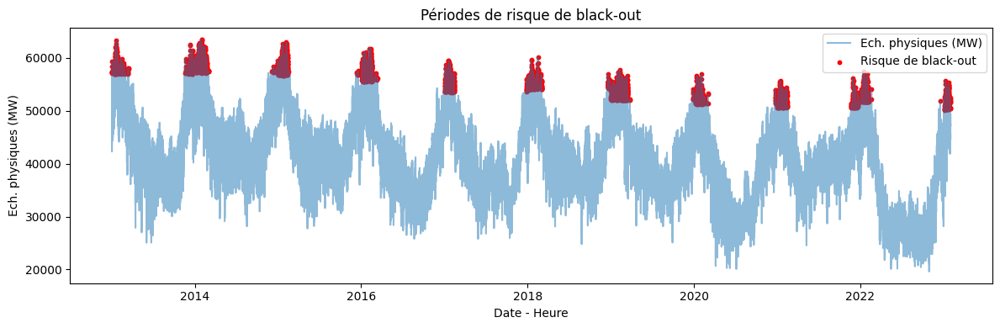

In [112]:
blackout_oui = df_blackout[df_blackout['Risque de black-out'] == 'OUI']

# Créer le graphique
plt.figure(figsize=(12, 4))
plt.plot(df_blackout['Date - Heure'], df_blackout['Ech. physiques (MW)'], label='Ech. physiques (MW)', alpha=0.5)
plt.scatter(blackout_oui['Date - Heure'], blackout_oui['Ech. physiques (MW)'], color='red', label='Risque de black-out', s=10)

plt.xlabel('Date - Heure')
plt.ylabel('Ech. physiques (MW)')
plt.title('Périodes de risque de black-out')
plt.legend()
plt.tight_layout()
plt.show()

On observe que le risque le plus grand de blackout est l'hiver, c'est à dire quand la demande est la plus forte, et la production solaire la plus faible. C'est tout à fait cohérent.

# Ajout du bruit

In [113]:
# Étape 1 : créer la colonne 'Production (MW)' à partir des filières
colonnes_production = [
    'Thermique (MW)',
    'Nucléaire (MW)',
    'Eolien (MW)',
    'Solaire (MW)',
    'Hydraulique (MW)',
    'Pompage (MW)',
    'Bioénergies (MW)'
]

# On remplace les NaN par 0 pour éviter des NaN dans la somme
df_no_nan['Production (MW)'] = df_no_nan[colonnes_production].fillna(0).sum(axis=1)

# Étape 2 : regrouper consommation et production par heure
agg_conso_prod = (
    df_no_nan
    .groupby('Date - Heure')[['Consommation (MW)', 'Production (MW)']]
    .sum()
    .reset_index()
)

# Étape 3 : fusionner avec df_blackout
df_blackout = df_blackout.merge(agg_conso_prod, on='Date - Heure', how='left')



In [114]:
np.random.seed(42)

moyenne_bruit = 0
ecart_type_bruit = 0.02

# Générer un bruit aléatoire selon une loi normale pour la consommation
bruit_conso = np.random.normal(loc=moyenne_bruit, scale=ecart_type_bruit, size=len(df_blackout))
df_blackout['Consommation avec bruit (MW)'] = df_blackout['Consommation (MW)'] * (1 + bruit_conso)

# Générer un bruit similaire pour la production
bruit_prod = np.random.normal(loc=moyenne_bruit, scale=ecart_type_bruit, size=len(df_blackout))
df_blackout['Production avec bruit (MW)'] = df_blackout['Production (MW)'] * (1 + bruit_prod)


In [115]:
df_blackout.head()

,Date - Heure,Ech. physiques (MW),Année,Seuil 90%,Risque de black-out,Consommation (MW),Production (MW),Consommation avec bruit (MW),Production avec bruit (MW)
0,2013-01-01 00:00:00+00:00,49512.5,2013,56946.6,NON,57806.5,64615.0,58380.766134,64832.449033
1,2013-01-01 01:00:00+00:00,49847.5,2013,56946.6,NON,56941.5,63574.5,56784.040466,62306.334676
2,2013-01-01 02:00:00+00:00,46477.0,2013,56946.6,NON,53497.0,59817.5,54189.987874,59888.854316
3,2013-01-01 03:00:00+00:00,43068.5,2013,56946.6,NON,50318.5,56328.5,51851.231557,55310.842244
4,2013-01-01 04:00:00+00:00,42493.5,2013,56946.6,NON,49022.0,54657.5,48792.426665,54241.001422


# Modèle de classification pour le risque de blackout

In [116]:
df_classi_blackout = df_blackout[[
    'Date - Heure',
    'Production avec bruit (MW)',
    'Consommation avec bruit (MW)'
]].copy()

# Variable cible séparée
y = df_blackout['Risque de black-out'].copy()


In [117]:
df_classi_blackout

,Date - Heure,Production avec bruit (MW),Consommation avec bruit (MW)
0,2013-01-01 00:00:00+00:00,64832.449033,58380.766134
1,2013-01-01 01:00:00+00:00,62306.334676,56784.040466
2,2013-01-01 02:00:00+00:00,59888.854316,54189.987874
3,2013-01-01 03:00:00+00:00,55310.842244,51851.231557
4,2013-01-01 04:00:00+00:00,54241.001422,48792.426665
...,...,...,...
88376,2023-01-31 18:00:00+00:00,64496.756576,71247.546484
88377,2023-01-31 19:00:00+00:00,66603.481780,70999.491302
88378,2023-01-31 20:00:00+00:00,66233.919173,66927.819005
88379,2023-01-31 21:00:00+00:00,64113.352476,63518.562890


In [118]:
print(y)

0        NON
1        NON
2        NON
3        NON
4        NON
        ... 
88376    NON
88377    NON
88378    NON
88379    NON
88380    NON
Name: Risque de black-out, Length: 88381, dtype: object


In [119]:
num_features = ['Consommation avec bruit (MW)', 'Production avec bruit (MW)']

# Préprocesseur = juste un StandardScaler (on a uniquement des valeurs numériques)
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), num_features)
    ]
)

On va tester les modèles suivants : KNN Classifier, Regression Logistic et Random Forest Classifier

In [120]:
num_features = ['Consommation avec bruit (MW)', 'Production avec bruit (MW)']

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), num_features)
    ]
)

# 3. Pipeline pour KNN
knn_clf = KNeighborsClassifier()
pipeline_knn = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', knn_clf)
])

# 4. Pipeline pour régression logistique
logistic_regression = LogisticRegression(max_iter=5000)
pipeline_reg_logi = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', logistic_regression)
])

# 5. Pipeline pour Random Forest (pas besoin de préprocessing)
rdm_forest_clf = RandomForestClassifier()
pipeline_rdm_forest = Pipeline(steps=[
    ('classifier', rdm_forest_clf)
])

In [121]:
X = df_classi_blackout[num_features]
y = df_blackout['Risque de black-out']  # valeurs "OUI"/"NON"
X, X_validation, y, y_validation = train_test_split(X, y, test_size=0.1, random_state=42)


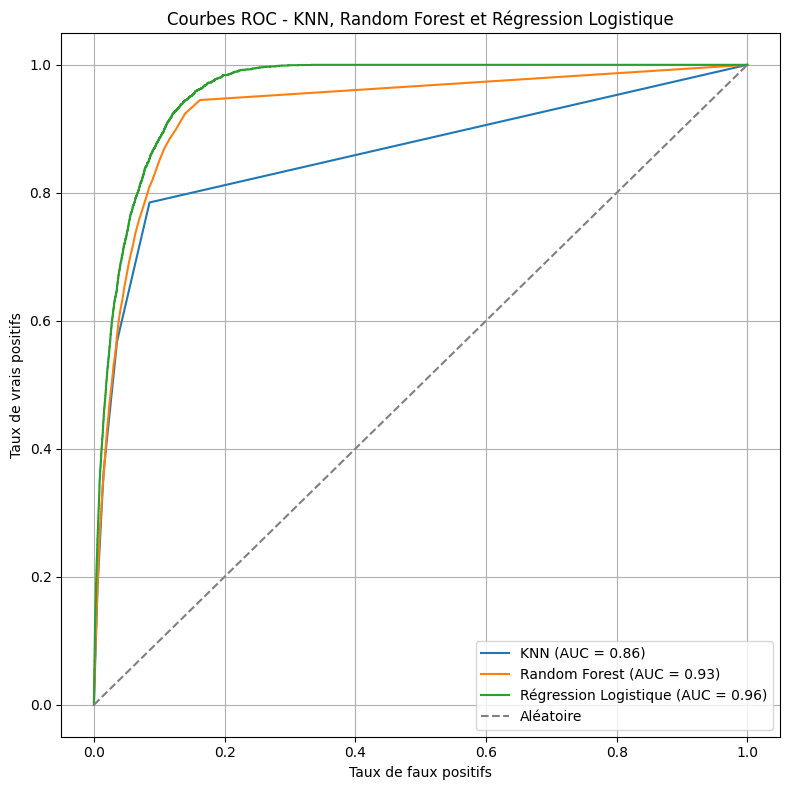

In [122]:

# Validation croisée stratifiée
n_splits = 3
cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# KNN
y_probas_knn = cross_val_predict(pipeline_knn, X, y, cv=cv, method='predict_proba')
fpr_knn, tpr_knn, _ = roc_curve(y, y_probas_knn[:, 1], pos_label="OUI")
roc_auc_knn = auc(fpr_knn, tpr_knn)

# Random Forest
y_probas_rdm_forest = cross_val_predict(pipeline_rdm_forest, X, y, cv=cv, method='predict_proba')
fpr_rdm_forest, tpr_rdm_forest, _ = roc_curve(y, y_probas_rdm_forest[:, 1], pos_label="OUI")
roc_auc_rdm_forest = auc(fpr_rdm_forest, tpr_rdm_forest)

# Régression logistique
y_probas_reg_logi = cross_val_predict(pipeline_reg_logi, X, y, cv=cv, method='predict_proba')
fpr_reg_logi, tpr_reg_logi, _ = roc_curve(y, y_probas_reg_logi[:, 1], pos_label="OUI")
roc_auc_reg_logi = auc(fpr_reg_logi, tpr_reg_logi)

# Tracer les courbes ROC
plt.figure(figsize=(8, 8))
plt.plot(fpr_knn, tpr_knn, label='KNN (AUC = {:.2f})'.format(roc_auc_knn))
plt.plot(fpr_rdm_forest, tpr_rdm_forest, label='Random Forest (AUC = {:.2f})'.format(roc_auc_rdm_forest))
plt.plot(fpr_reg_logi, tpr_reg_logi, label='Régression Logistique (AUC = {:.2f})'.format(roc_auc_reg_logi))
plt.plot([0, 1], [0, 1], linestyle='--', color='grey', label='Aléatoire')
plt.xlabel('Taux de faux positifs')
plt.ylabel('Taux de vrais positifs')
plt.title('Courbes ROC - KNN, Random Forest et Régression Logistique')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [123]:
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Utilisez make_scorer pour définir le rappel comme métrique de score
scorer = make_scorer(recall_score, pos_label="OUI")  # Assurez-vous de spécifier le pos_label approprié

# Effectuez la validation croisée en utilisant le rappel comme métrique
recall_scores_reg_logi = cross_val_score(pipeline_reg_logi,X , y, cv=cv, scoring=scorer)
recall_scores_knn = cross_val_score(pipeline_knn,X , y, cv=cv, scoring=scorer)
recall_scores_rdm_forest = cross_val_score(pipeline_rdm_forest,X , y, cv=cv, scoring=scorer)




mean_recall_reg_logi = recall_scores_reg_logi.mean()
mean_recall_knn = recall_scores_knn.mean()
mean_recall_rdm_forest = recall_scores_rdm_forest.mean()





print("Mean recall of KNN on all cross validations:", mean_recall_knn)
print("Mean recall of Logistic Regression Rappel moyen de la régression logique on all cross validations:", mean_recall_reg_logi)
print("Mean recall of Random Forest on all cross validations:", mean_recall_rdm_forest)





Mean recall of KNN on all cross validations: 0.36281943274361134
Mean recall of Logistic Regression Rappel moyen de la régression logique on all cross validations: 0.347655153046897
Mean recall of Random Forest on all cross validations: 0.35355237292895253


On ne veut pas ne pas réussir à prédir un blackout qui se réaliserait. Donc la métrique pertinente est le recall dans notre situation. KNN et le random forest ont les meilleurs recall. Toutefois, le compromis recall/précision apparait meilleur pour le random forest sur les courbes ROC. On poursuit donc avec random forest.

# Amélioration du modèle et hyperparamètres

In [124]:
X[num_features].head()

,Consommation avec bruit (MW),Production avec bruit (MW)
30826,54209.278523,59463.254306
7687,57171.750963,57732.288256
54095,59568.731164,67814.290363
28127,59421.475576,64618.566347
42236,45848.751618,49129.133327


In [125]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from scipy.stats import randint
param_distributions = {
    'classifier__n_estimators': randint(50, 150),
    'classifier__max_depth': [None, 10, 30],
    'classifier__min_samples_split': randint(2, 10),
    'classifier__min_samples_leaf': randint(1, 5)
}

# 5. Validation croisée stratifiée
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# 6. Echantillonnage de 30 % du jeu de données
X_sample = X.sample(frac=0.1, random_state=42)
y_sample = y.loc[X_sample.index]

# 7. RandomizedSearchCV avec scoring sur le recall
random_search = RandomizedSearchCV(
    estimator=pipeline_rdm_forest,
    param_distributions=param_distributions,
    n_iter=30,                # 30 combinaisons aléatoires
    cv=cv,
    scoring='recall',
    n_jobs=-1,
    verbose=1,
    random_state=42
)

# 8. Lancer la recherche sur l'échantillon
random_search.fit(X_sample, y_sample)

# 9. Afficher les meilleurs hyperparamètres
print("Meilleurs paramètres :", random_search.best_params_)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_search.py:1108: UserWarning:

One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan]



Meilleurs paramètres : {'classifier__max_depth': 30, 'classifier__min_samples_leaf': 4, 'classifier__min_samples_split': 6, 'classifier__n_estimators': 64}


# Evaluation on the test set

In [126]:
final_clf=RandomForestClassifier(max_depth=30, n_estimators=100, min_samples_leaf=4,min_samples_split=6, random_state=42)
pipeline_final=Pipeline(steps=[('classifier',final_clf)])
pipeline_final.fit(X,y)
y_pred_validation = pipeline_final.predict(X_validation)

import math
recall = recall_score(y_validation, y_pred_validation, pos_label='OUI')
truncated_recall = math.trunc(recall * 100) / 100


print (f"Recall of Random Forest Tuned = {truncated_recall}")

Recall of Random Forest Tuned = 0.4
